In [ ]:
# audio libraries
import librosa
import librosa.display as lplt
import IPython
from scipy.signal import find_peaks

# import matplotlib to be able to display graphs
import matplotlib.pyplot as plt

# transform .wav into .csv
import csv
import os
import numpy as np
import pandas as pd
from tqdm import tqdm

# preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# model
import keras
import tensorflow as tf
from tensorflow.keras.models import Sequential

## Connect to kaggle to download the dataset

In [ ]:
!pip install -q kaggle

!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/

!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d shreyj1729/best-of-watkins-marine-mammal-sound-database

Dataset URL: https://www.kaggle.com/datasets/shreyj1729/best-of-watkins-marine-mammal-sound-database
License(s): unknown
100% 6.67G/6.68G [01:24<00:00, 77.9MB/s]
100% 6.68G/6.68G [01:24<00:00, 84.7MB/s]


In [ ]:
!unzip -q best-of-watkins-marine-mammal-sound-database.zip "data/*"

## EDA (Exploratory data analysis)

In [ ]:
best_of_watkins = {
    'AtlanticSpottedDolphin', 'BeardedSeal', 'Beluga_WhiteWhale', 'BottlenoseDolphin',
    'BowheadWhale', 'Boutu_AmazonRiverDolphin', 'ClymeneDolphin', 'CommonDolphin', 'FalseKillerWhale', 'Fin_FinbackWhale',
    "Fraser'sDolphin", "Grampus_Risso'sDolphin", 'HarpSeal', 'HumpbackWhale', 'KillerWhale', 'LeopardSeal',
    'Long_FinnedPilotWhale', 'MelonHeadedWhale', 'MinkeWhale', 'Narwhal', 'NorthernRightWhale',
    'PantropicalSpottedDolphin', 'RossSeal', 'Rough_ToothedDolphin', 'Short_Finned(Pacific)PilotWhale',
    'SouthernRightWhale', 'SpermWhale', 'SpinnerDolphin', 'StripedDolphin', 'Walrus', 'WeddellSeal',
    'White_beakedDolphin', 'White_sidedDolphin'
}

In [ ]:
def fft_wrapper(signal, sampling_rate, return_val=False):
    fft_values = np.fft.fft(signal)
    nyquist = len(signal) // 2
    fft_magnitude = np.abs(fft_values[:nyquist]) / (len(signal) / 2)
    freqs = np.fft.fftfreq(len(signal), 1 / sampling_rate)[:nyquist]

    if return_val:
        return freqs, fft_magnitude, fft_values

    return freqs, fft_magnitude

In [ ]:
def teager_kaiser_energy(signal):
    return signal**2 - np.roll(signal, 1) * np.roll(signal, -1)

In [ ]:
main_dir = './data'
dir_and_files = []

for subdir in sorted(os.listdir(main_dir)):
    if subdir not in best_of_watkins:
        print(f"Skipping '{subdir}'.")
        continue
    subdir_path = os.path.join(main_dir, subdir)
    if os.path.isdir(subdir_path):
        files = sorted(os.listdir(subdir_path))
        if files:
            dir_and_files.append((subdir, os.path.join(subdir_path, files[0])))
            # dir_and_files.append((subdir, [os.path.join(subdir_path, f) for f in files[:5]]))

Skipping 'BlueWhale'.
Skipping 'Commerson'sDolphin'.
Skipping 'Dall'sPorpoise'.
Skipping 'DuskyDolphin'.
Skipping 'FinlessPorpoise'.
Skipping 'GraySeal'.
Skipping 'GrayWhale'.
Skipping 'HarborPorpoise'.
Skipping 'HarbourSeal'.
Skipping 'Heaviside'sDolphin'.
Skipping 'HoodedSeal'.
Skipping 'IrawaddyDolphin'.
Skipping 'JuanFernandezFurSeal'.
Skipping 'LongBeaked(Pacific)CommonDolphin'.
Skipping 'NewZealandFurSeal'.
Skipping 'RibbonSeal'.
Skipping 'RingedSeal'.
Skipping 'SeaOtter'.
Skipping 'SpottedSeal'.
Skipping 'StellerSeaLion'.
Skipping 'TucuxiDolphin'.
Skipping 'WestIndianManatee'.


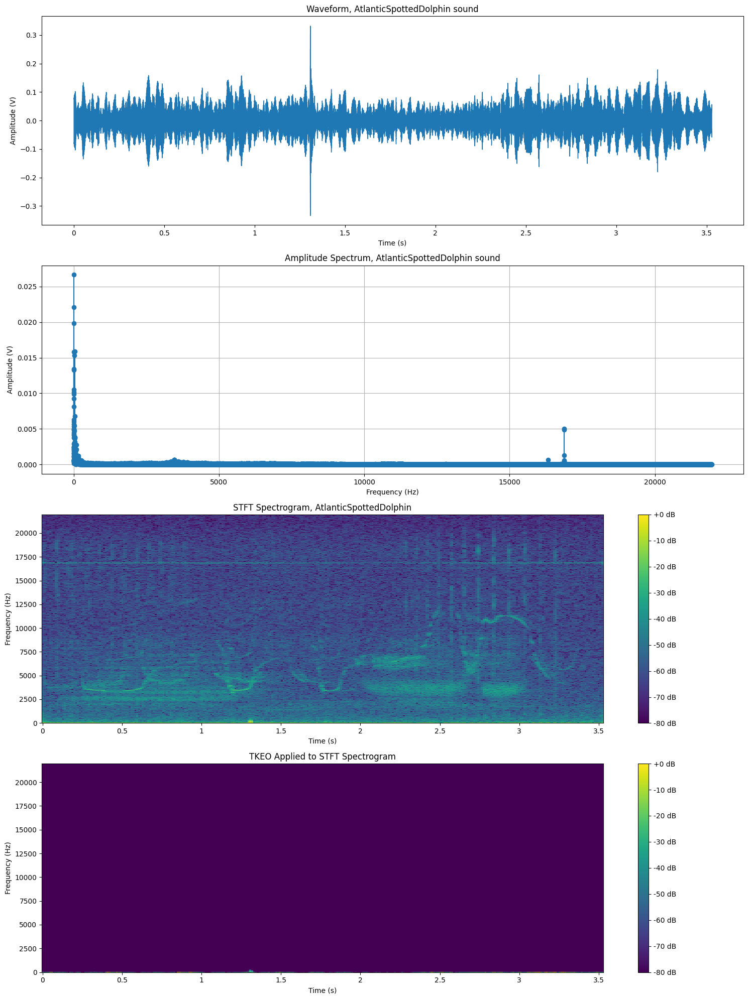

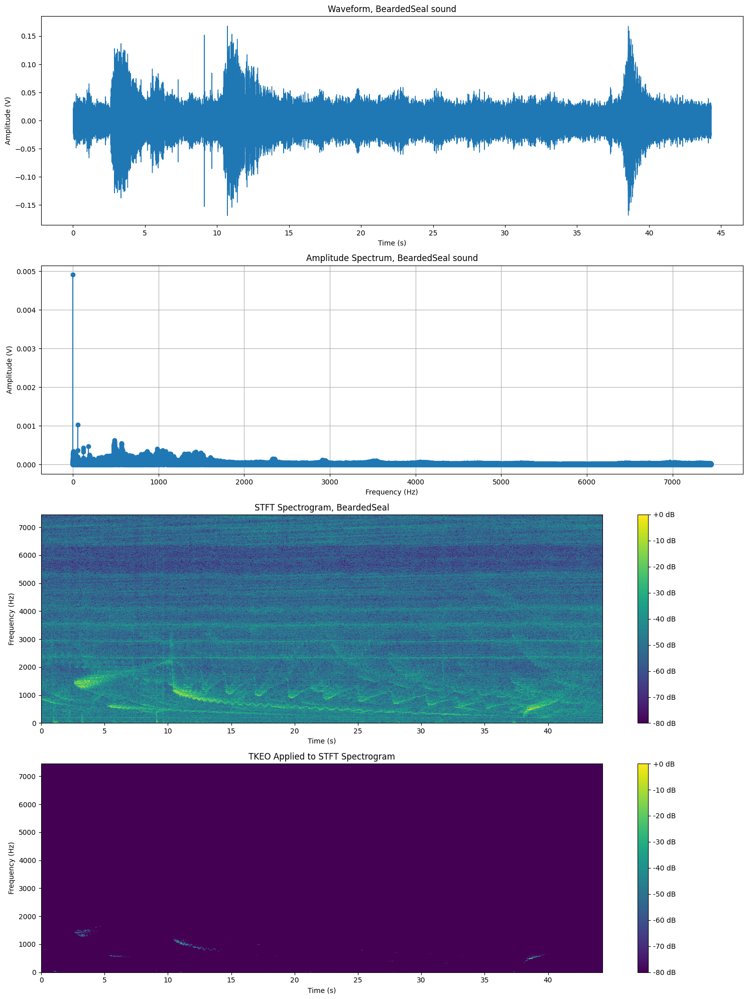

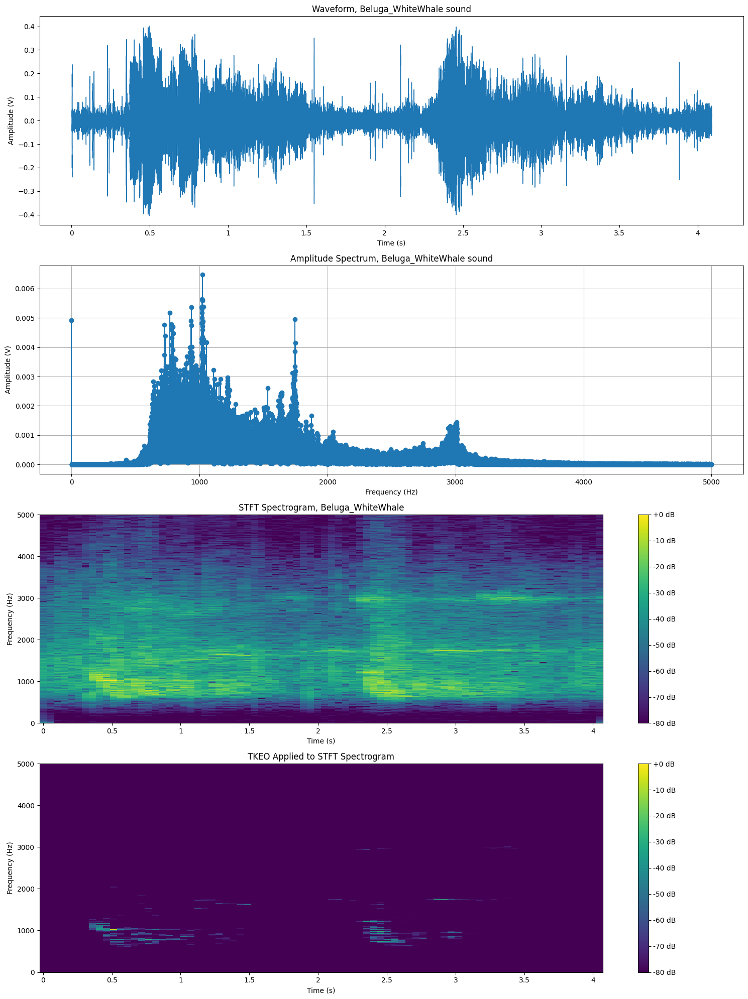

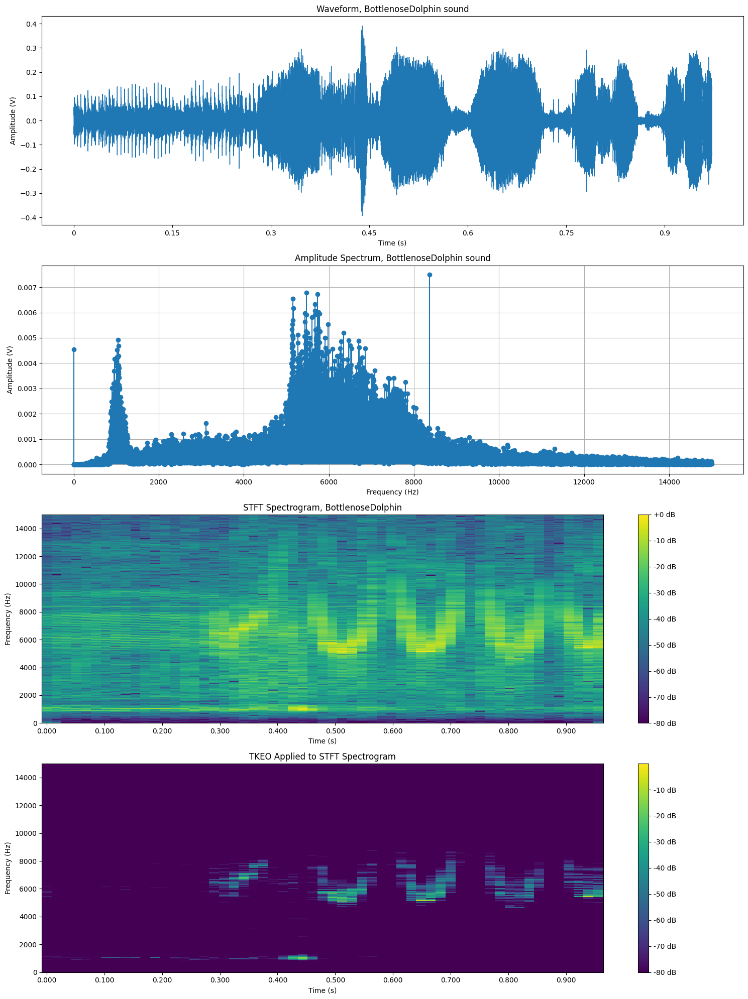

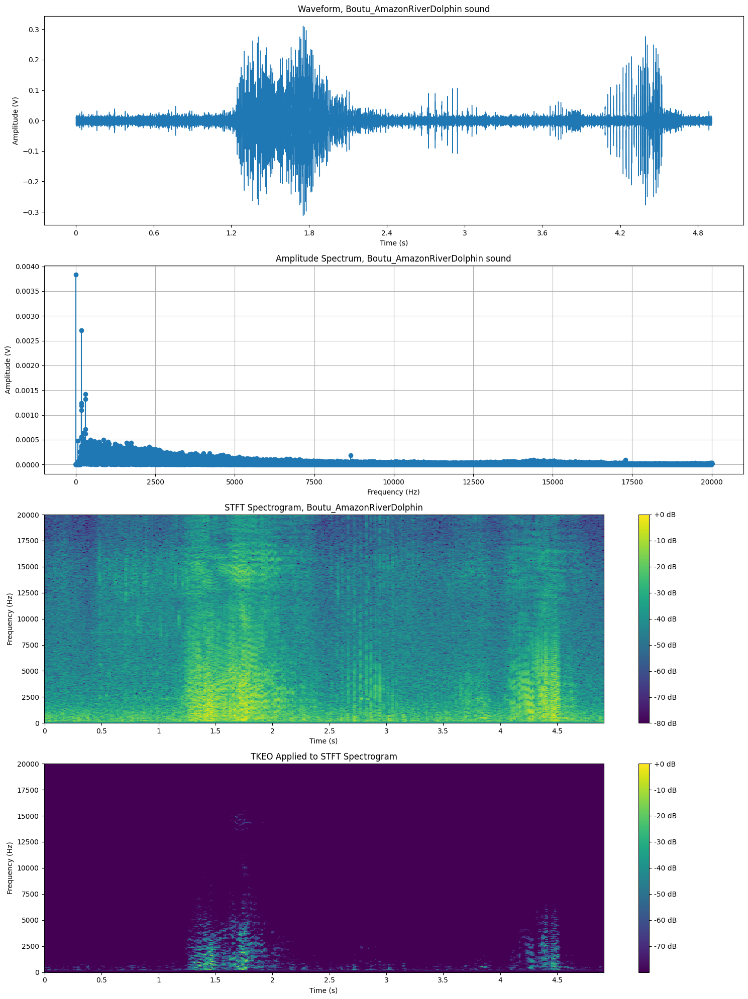

...

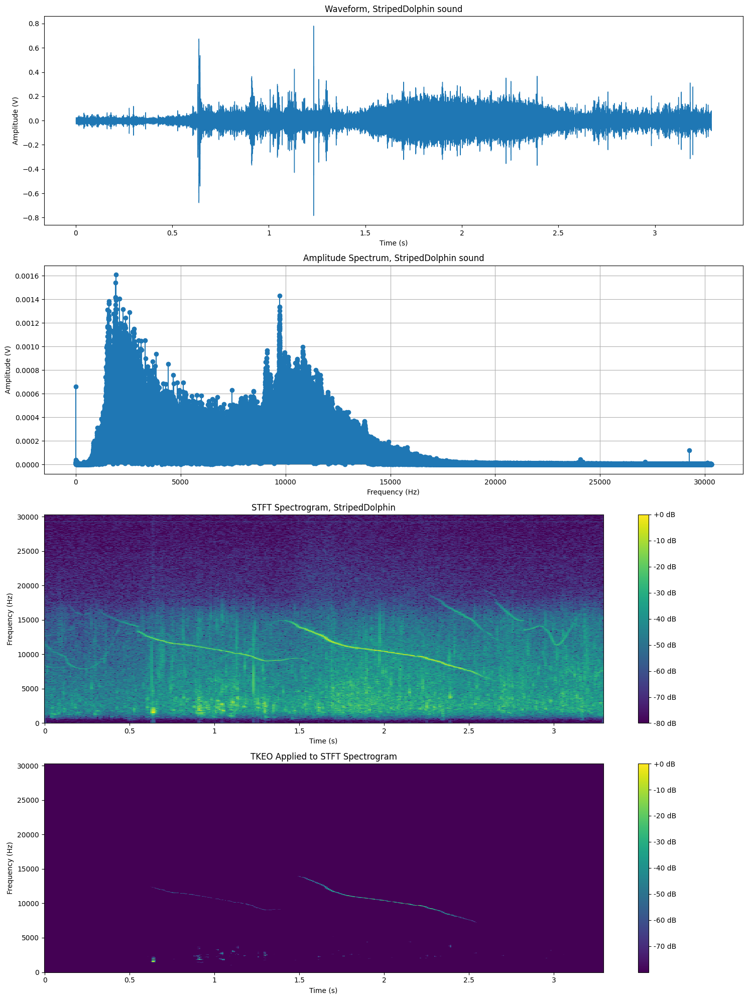

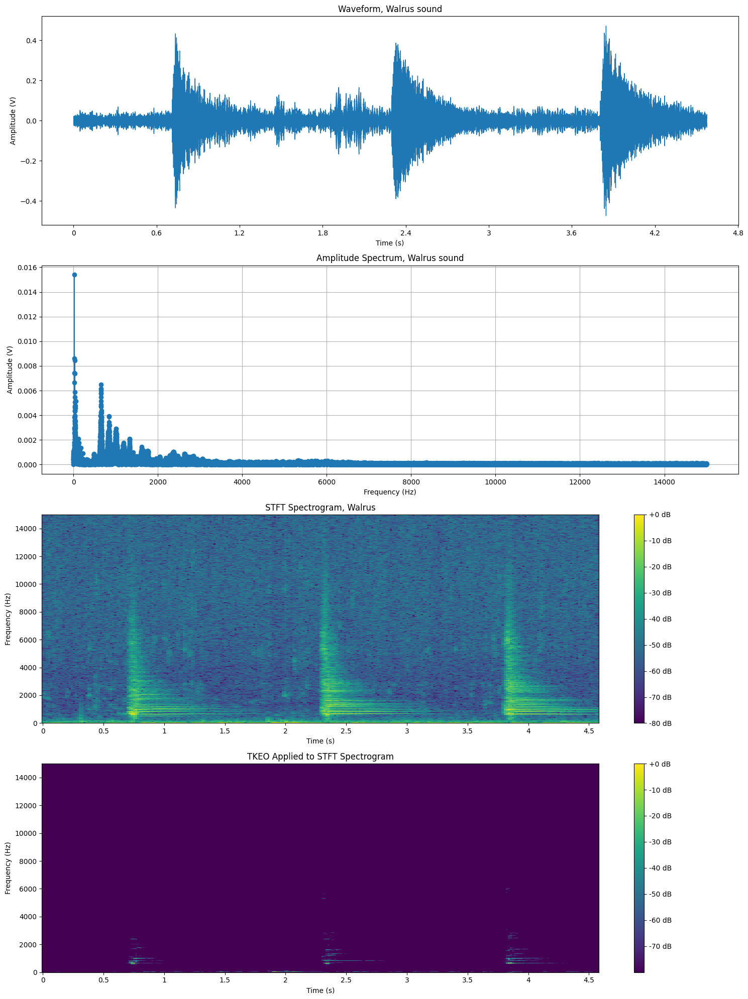

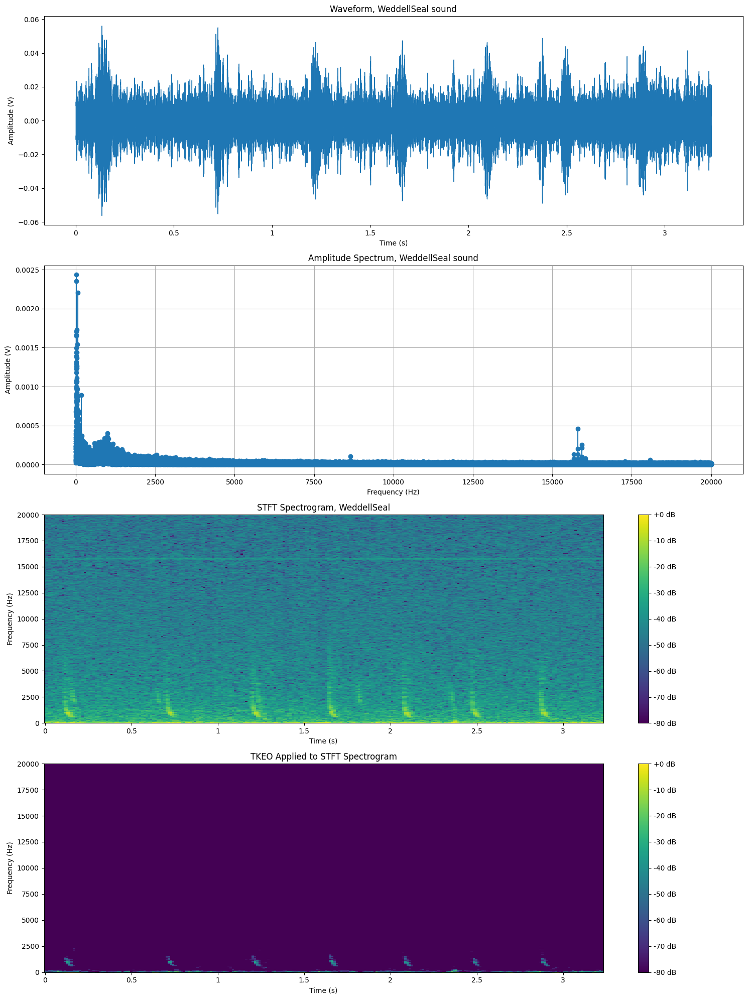

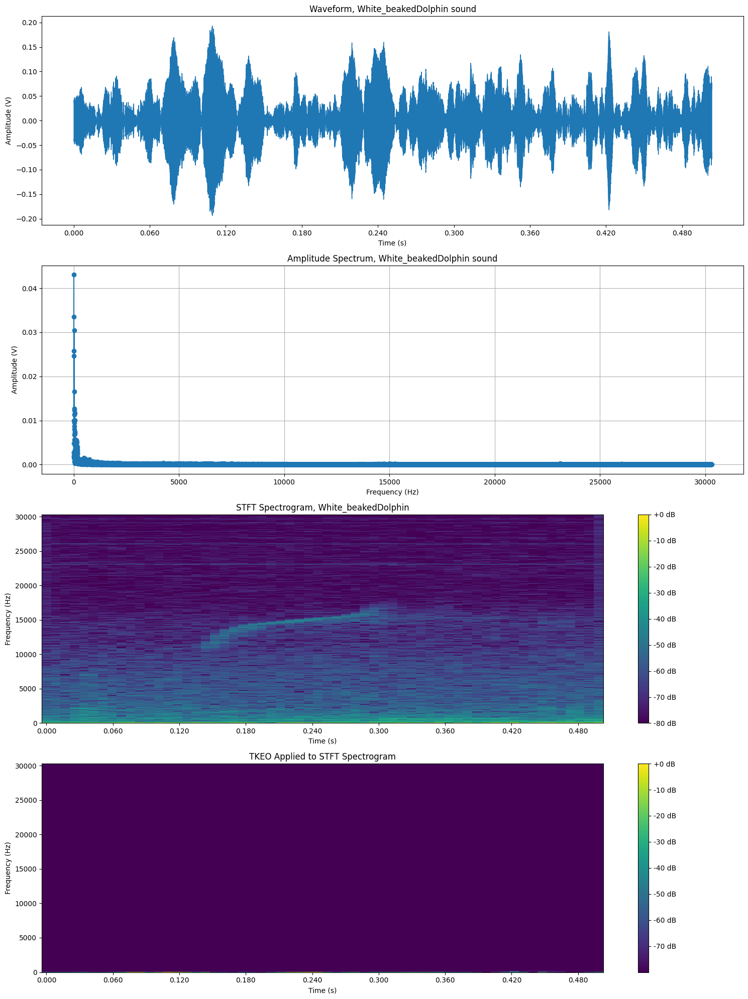

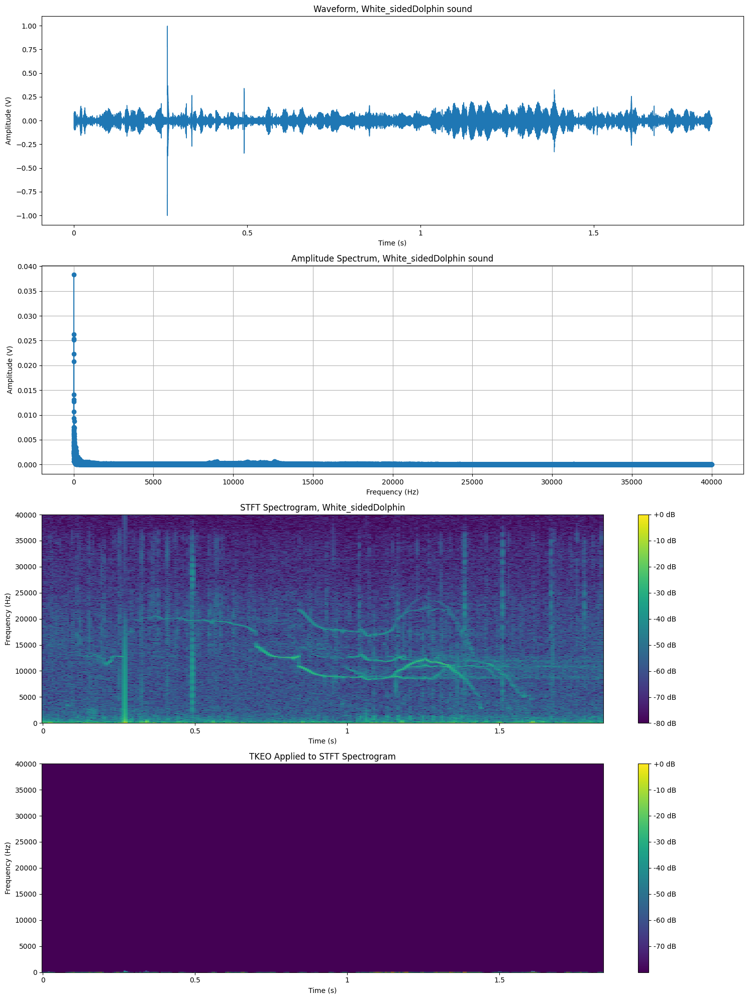

In [ ]:
import soundfile as sf
for dir_name, audio_path in dir_and_files:
    display(IPython.display.Audio(audio_path))

    y, sr = librosa.load(audio_path, sr=None)
    freqs, fft_magnitude, fft_vals = fft_wrapper(y, sr, return_val=True)

    S = librosa.stft(y=y, n_fft=2048, hop_length=512, window='hann')
    S_dB = librosa.amplitude_to_db(np.abs(S), ref=np.max)

    S_pow = np.abs(S)**2
    tkeo_on_spectrogram = teager_kaiser_energy(S_pow.flatten()).reshape(S_pow.shape)

    fig, axes = plt.subplots(4, 1, figsize=(15, 20))

    # Waveform
    librosa.display.waveshow(y, sr=sr, ax=axes[0])
    axes[0].set_title(f'Waveform, {dir_name} sound')
    axes[0].set_xlabel('Time (s)')
    axes[0].set_ylabel('Amplitude (V)')

    # Amplitude Spectrum
    axes[1].stem(freqs, fft_magnitude, basefmt=" ")
    axes[1].set_title(f'Amplitude Spectrum, {dir_name} sound')
    axes[1].set_xlabel('Frequency (Hz)')
    axes[1].set_ylabel('Amplitude (V)')
    axes[1].grid(True)

    # STFT Spectrogram
    img = librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='linear', cmap='viridis', ax=axes[2])
    fig.colorbar(img, ax=axes[2], format='%+2.0f dB')
    axes[2].set_title(f'STFT Spectrogram, {dir_name}')
    axes[2].set_xlabel('Time (s)')
    axes[2].set_ylabel('Frequency (Hz)')

    # TKEO Applied to STFT Spectrogram
    img_tkeo = librosa.display.specshow(librosa.amplitude_to_db(tkeo_on_spectrogram, ref=np.max),
                                        sr=sr, x_axis='time', y_axis='linear', cmap='viridis', ax=axes[3])
    fig.colorbar(img_tkeo, ax=axes[3], format='%+2.0f dB')
    axes[3].set_title('TKEO Applied to STFT Spectrogram')
    axes[3].set_xlabel('Time (s)')
    axes[3].set_ylabel('Frequency (Hz)')

    plt.tight_layout()
    plt.show()


### Dataset features

In [ ]:
all_folders = os.listdir(main_dir)

species_count = 0
total_audio_files = 0
folder_file_counts = {}
sampling_rates = []
durations = []

for folder in all_folders:
    folder_path = os.path.join(main_dir, folder)

    if not os.path.isdir(folder_path):
        print(f"Skipping '{folder}' as it is not a directory.")
        continue
    if folder not in best_of_watkins:
        print(f"Skipping '{folder}'.")
        continue

    species_count += 1

    files = os.listdir(folder_path)

    audio_count = 0

    for file in files:
        if file.lower().endswith(('.wav', '.mp3')):
            audio_count += 1
            file_path = os.path.join(folder_path, file)

            try:
                signal, sr = librosa.load(file_path, sr=None)
                sampling_rates.append(sr)
                durations.append((len(signal) - 1) / sr)
            except Exception as e:
                print(f"Error processing {file_path}: {e}")

    folder_file_counts[folder] = audio_count
    total_audio_files += audio_count

    print(f"- {folder}: {audio_count} audio file(s)")

if sampling_rates:
    min_sr = min(sampling_rates)
    max_sr = max(sampling_rates)
    avg_sr = np.mean(sampling_rates)
    sr_range = max_sr - min_sr

    print("\nSampling Rate Statistics:")
    print(f"Range: {sr_range}")
    print(f"Minimum: {min_sr} Hz")
    print(f"Maximum: {max_sr} Hz")
    print(f"Average: {avg_sr:.2f} Hz")

if durations:
    min_duration = min(durations)
    max_duration = max(durations)
    avg_duration = np.mean(durations)
    duration_range = max_duration - min_duration

    print("\nDuration Statistics:")
    print(f"Range: {duration_range:.2f} seconds")
    print(f"Minimum: {min_duration:.2f} seconds")
    print(f"Maximum: {max_duration:.2f} seconds")
    print(f"Average: {avg_duration:.2f} seconds")

print(f"\nTotal number of species (folders): {species_count}")
print(f"\nTotal number of audio files: {total_audio_files}")

Skipping 'LongBeaked(Pacific)CommonDolphin'.
Skipping 'SpottedSeal'.
- SouthernRightWhale: 49 audio file(s)
Skipping 'FinlessPorpoise'.
- BottlenoseDolphin: 189 audio file(s)
Skipping 'SeaOtter'.
- SpinnerDolphin: 524 audio file(s)
- Walrus: 273 audio file(s)
- Beluga_WhiteWhale: 150 audio file(s)
- StripedDolphin: 681 audio file(s)
Skipping 'Commerson'sDolphin'.
Skipping 'RibbonSeal'.
- KillerWhale: 2647 audio file(s)
- BeardedSeal: 142 audio file(s)
Skipping 'NewZealandFurSeal'.
Skipping 'TucuxiDolphin'.
- White_beakedDolphin: 196 audio file(s)
- Fin_FinbackWhale: 583 audio file(s)
Skipping 'JuanFernandezFurSeal'.
Skipping 'GraySeal'.
Skipping 'StellerSeaLion'.
Skipping 'WestIndianManatee'.
- Grampus_Risso'sDolphin: 359 audio file(s)
Skipping 'IrawaddyDolphin'.
- Long_FinnedPilotWhale: 1213 audio file(s)
Skipping 'HarbourSeal'.
Skipping 'RingedSeal'.
- FalseKillerWhale: 508 audio file(s)
- WeddellSeal: 133 audio file(s)
- MinkeWhale: 24 audio file(s)
- HarpSeal: 47 audio file(s)
- Le

### Distribution of sampling rates

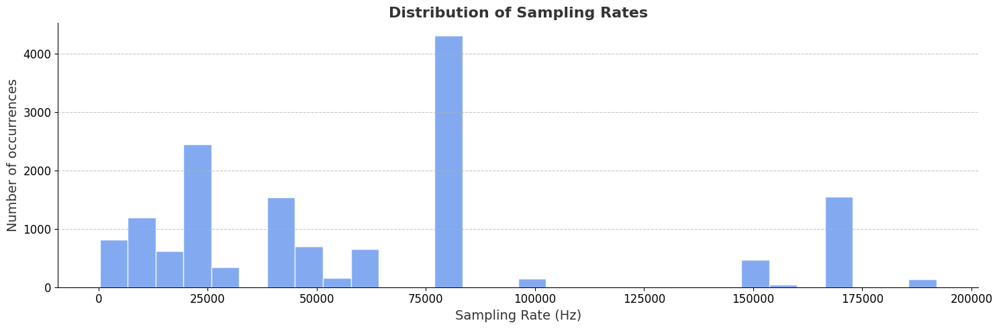

In [ ]:
plt.figure(figsize=(15, 5))
plt.hist(sampling_rates, bins=30, edgecolor='white', color='#6495ED', alpha=0.8)
plt.title("Distribution of Sampling Rates", fontsize=16, fontweight='bold', color='#333333')
plt.xlabel("Sampling Rate (Hz)", fontsize=14, color='#333333')
plt.ylabel("Number of occurrences", fontsize=14, color='#333333')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

In [ ]:
def count_avrg(folder_file_counts, data):
    species_avg_data = {}
    index = 0

    for species, file_count in folder_file_counts.items():
        species_data = data[index:index + file_count]
        total_data = np.sum(species_data)
        species_avg_data[species] = total_data / file_count
        index += file_count
    return species_avg_data

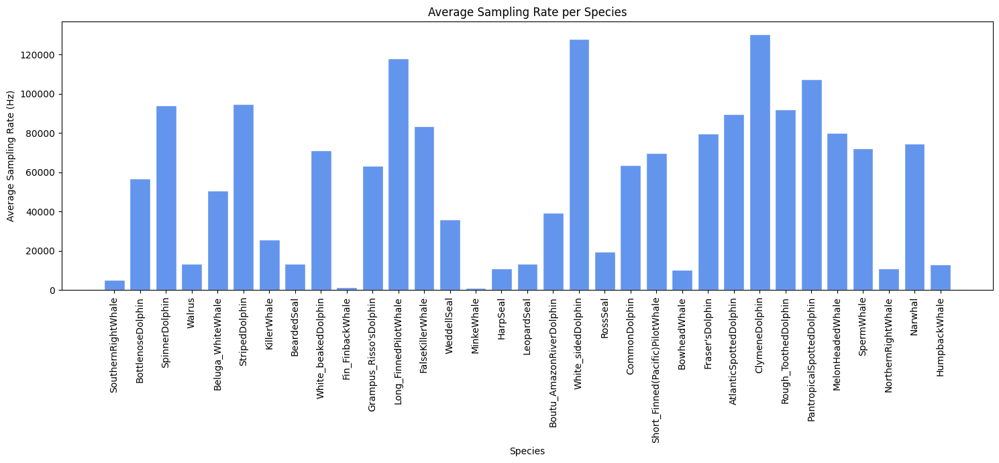

In [ ]:
species_avg_sampling_rate = count_avrg(folder_file_counts, sampling_rates)

species = list(species_avg_sampling_rate.keys())
avg_rates = list(species_avg_sampling_rate.values())

plt.figure(figsize=(15, 7))
plt.bar(species, avg_rates, color='#6495ED', edgecolor='white')
plt.xlabel('Species')
plt.ylabel('Average Sampling Rate (Hz)')
plt.title('Average Sampling Rate per Species')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

### Distribution of durations

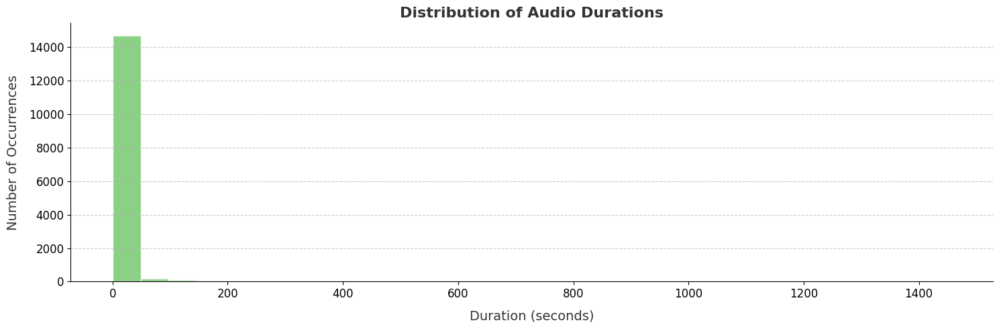

In [ ]:
plt.figure(figsize=(15, 5))
plt.hist(durations, bins=30, edgecolor='white', color='#70c568', alpha=0.8)
plt.title("Distribution of Audio Durations", fontsize=16, fontweight='bold', color='#333333')
plt.xlabel("Duration (seconds)", fontsize=14, labelpad=10, color='#333333')
plt.ylabel("Number of Occurrences", fontsize=14, labelpad=10, color='#333333')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

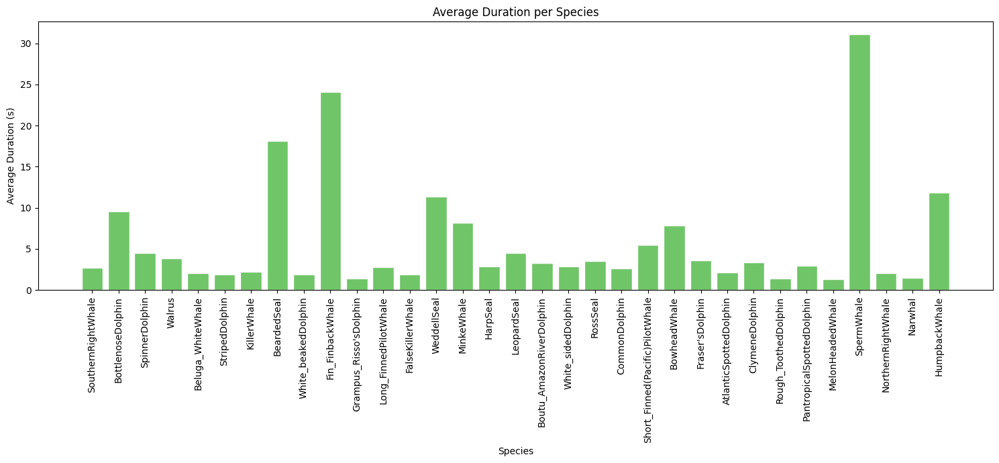

In [ ]:
species_avg_duration = count_avrg(folder_file_counts, durations)

species = list(species_avg_duration.keys())
avg_durations = list(species_avg_duration.values())

plt.figure(figsize=(15, 7))
plt.bar(species, avg_durations, color='#70c568', edgecolor='white')
plt.xlabel('Species')
plt.ylabel('Average Duration (s)')
plt.title('Average Duration per Species')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

### Number of audio files per folder

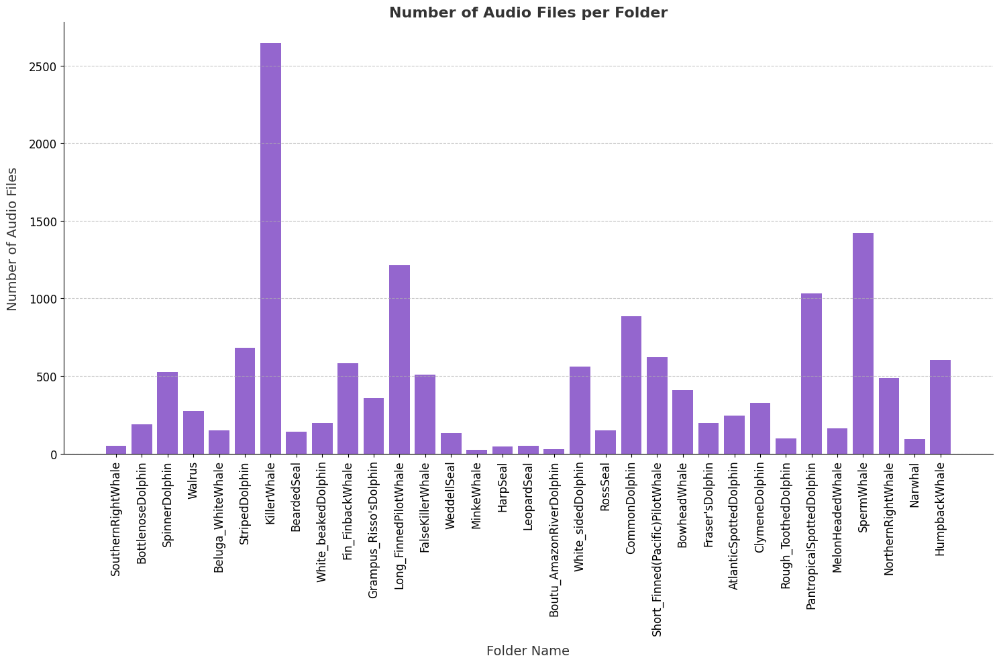

In [ ]:
plt.figure(figsize=(15, 10))
plt.bar(folder_file_counts.keys(), folder_file_counts.values(), color='#9466ce')
plt.xticks(rotation=90)
plt.title("Number of Audio Files per Folder", fontsize=16, fontweight='bold', color='#333333')
plt.xlabel("Folder Name", fontsize=14, labelpad=10, color='#333333')
plt.ylabel("Number of Audio Files", fontsize=14, labelpad=10, color='#333333')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

## Example

In [ ]:
humpback_whale = "./data/HumpbackWhale/5401800A.wav"

walrus = "./data/Walrus/7200200A.wav"

striped_dolphin = "./data/StripedDolphin/5801100P.wav"

bearded_seal = "./data/BeardedSeal/66039002.wav"

white_sided_dolphin = "./data/White_sidedDolphin/6107200A.wav"

risso_dolphin = "./data/Grampus_Risso'sDolphin/59030003.wav"

orca = "./data/KillerWhale/60012009.wav"

atlantic_dolphin = "./data/AtlanticSpottedDolphin/61025001.wav"

In [ ]:
data, sr = librosa.load(striped_dolphin)
print(type(data), type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [ ]:
IPython.display.Audio(data, rate = sr)

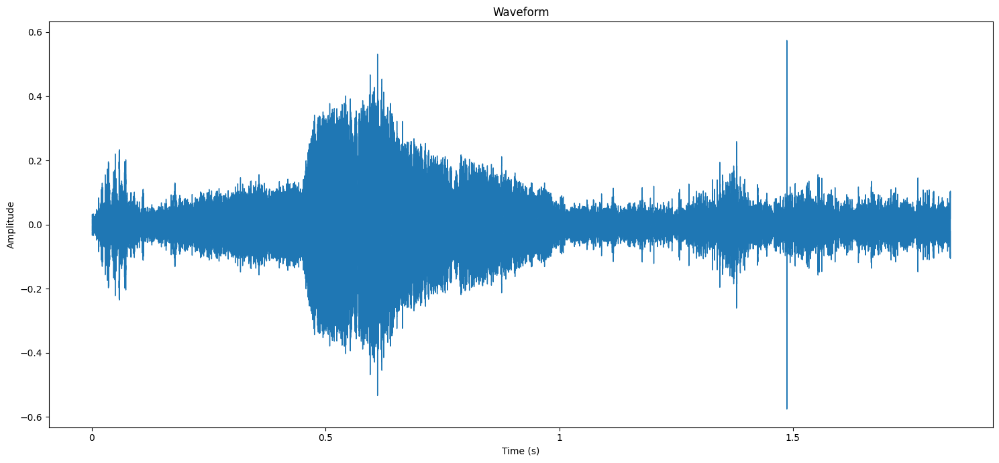

In [ ]:
plt.figure(figsize=(15, 7))
librosa.display.waveshow(data, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.tight_layout()
plt.show()

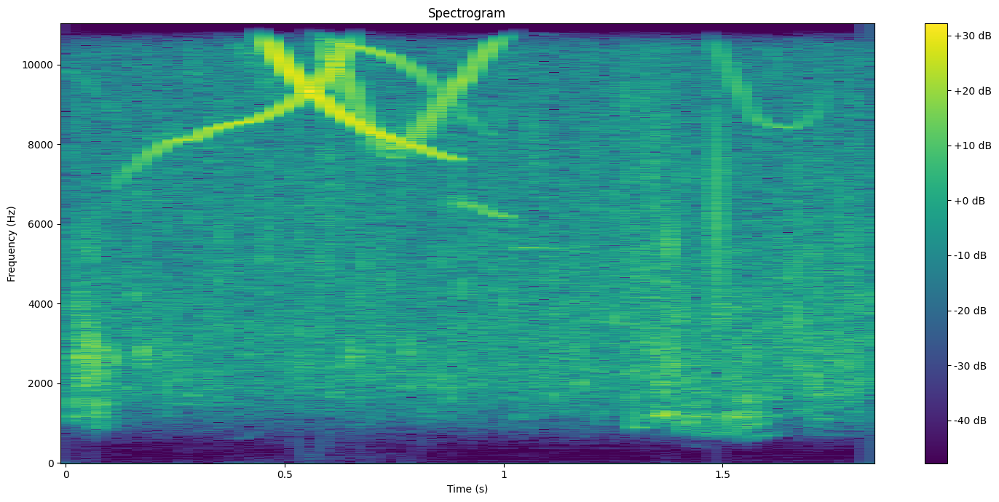

In [ ]:
stft = librosa.stft(data, window='hann')
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize=(15, 7))
spec = librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='viridis')
plt.colorbar(spec, format='%+2.0f dB')
plt.title('Spectrogram')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.tight_layout()
plt.show()

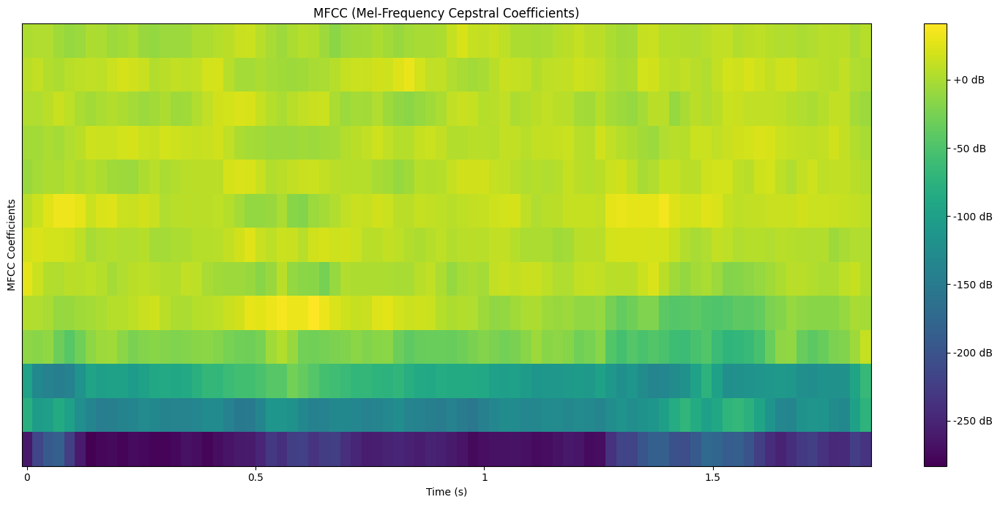

In [ ]:
mfcc = librosa.feature.mfcc(y=data, sr=sr, n_mfcc=13)

plt.figure(figsize=(15, 7))
librosa.display.specshow(mfcc, sr=sr, x_axis='time', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('MFCC (Mel-Frequency Cepstral Coefficients)')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficients')
plt.tight_layout()
plt.show()

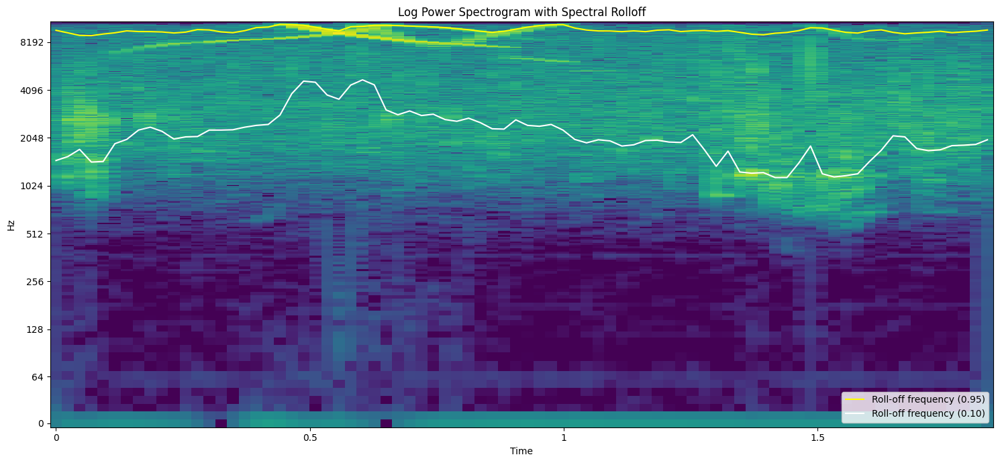

In [ ]:
S, phase = librosa.magphase(librosa.stft(data))
rolloff = librosa.feature.spectral_rolloff(S=S, sr=sr, roll_percent=0.95)
rolloff_min = librosa.feature.spectral_rolloff(y=data, sr=sr, roll_percent=0.1)
fig, ax = plt.subplots(figsize=(15, 7))

librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax, cmap='viridis')

ax.plot(librosa.times_like(rolloff), rolloff[0], label='Roll-off frequency (0.95)', color='yellow')
ax.plot(librosa.times_like(rolloff_min), rolloff_min[0], color='white', label='Roll-off frequency (0.10)')

ax.legend(loc='lower right')
ax.set(title='Log Power Spectrogram with Spectral Rolloff')

plt.tight_layout()
plt.show()

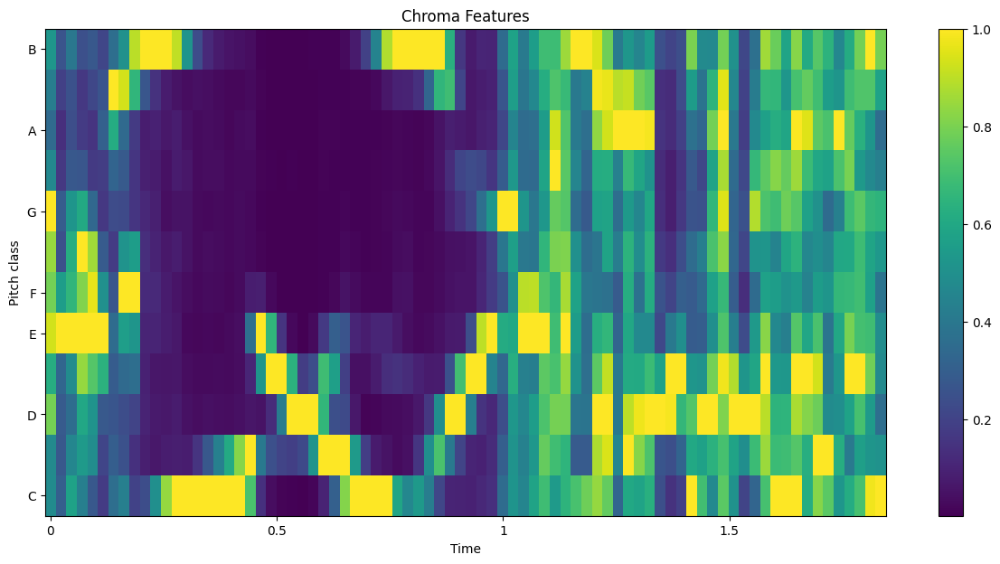

In [ ]:
plt.figure(figsize=(15, 7))
chroma = librosa.feature.chroma_stft(y=data, sr = sr)
lplt.specshow(chroma, sr = sr, x_axis = "time" ,y_axis = "chroma", cmap = "viridis")
plt.colorbar()
plt.title("Chroma Features")
plt.show()


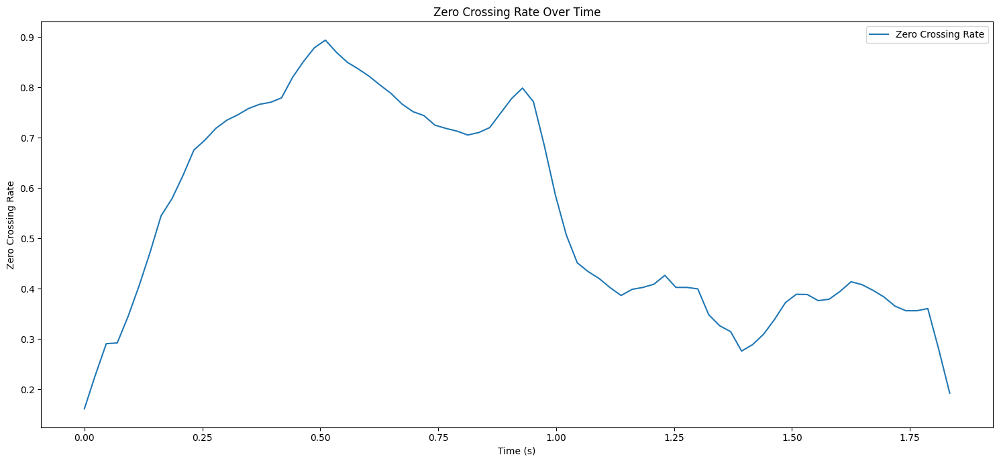

In [ ]:
zcr = librosa.feature.zero_crossing_rate(y=data)[0]
plt.figure(figsize=(15, 7))
plt.plot(librosa.times_like(zcr), zcr, label='Zero Crossing Rate')
plt.title('Zero Crossing Rate Over Time')
plt.xlabel('Time (s)')
plt.ylabel('Zero Crossing Rate')

plt.tight_layout()
plt.legend(loc='upper right')
plt.show()

## TKEO

In [ ]:
def teager_kaiser_energy(signal):
    energy = np.zeros_like(signal)
    energy[1:-1] = signal[1:-1]**2 - signal[:-2] * signal[2:]
    return energy


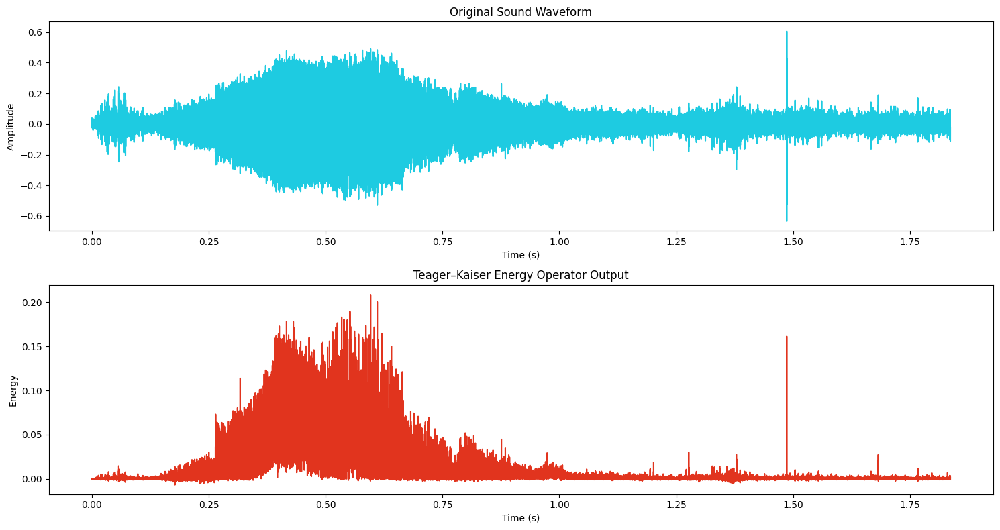

In [ ]:
y, sr = librosa.load(striped_dolphin, sr=None, mono=True)

tkeo_output = teager_kaiser_energy(y)
time = np.linspace(0, len(y) / sr, len(y))

plt.figure(figsize=(15, 8))
plt.subplot(2, 1, 1)
plt.plot(time, y, color='#1ECBE1')
plt.title('Original Sound Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(time, tkeo_output, color='#E1341E')
plt.title('Teager–Kaiser Energy Operator Output')
plt.xlabel('Time (s)')
plt.ylabel('Energy')

plt.tight_layout()
plt.show()

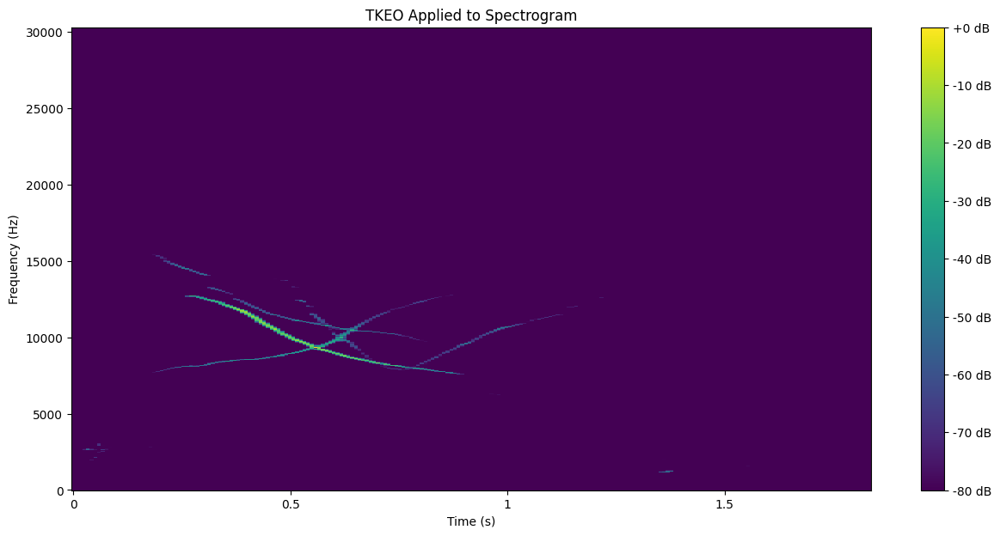

In [ ]:
D = librosa.stft(y=y, n_fft=2048, hop_length=512, window='hann')
S = np.abs(D)**2
def teager_kaiser_energy(signal):
    return signal**2 - np.roll(signal, 1) * np.roll(signal, -1)

tkeo_on_spectrogram = teager_kaiser_energy(S.flatten()).reshape(S.shape)

plt.figure(figsize=(15, 7))
librosa.display.specshow(librosa.amplitude_to_db(tkeo_on_spectrogram, ref=np.max),
                         sr=sr, x_axis='time', y_axis='linear', cmap='viridis')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(format='%+2.0f dB')
plt.title('TKEO Applied to Spectrogram')
plt.show()

## Dataset composition

In [ ]:
columns = ['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean', 'rms_var',
           'spectral_centroid_mean', 'spectral_centroid_var', 'spectral_bandwidth_mean', 'spectral_bandwidth_var',
           'rolloff_mean', 'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
           'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean', 'mfcc3_var',
           'mfcc4_mean', 'mfcc4_var', 'spectrogram', 'spec_tkeo', 'label']

In [ ]:
best_of_watkins = {
    'AtlanticSpottedDolphin', 'BeardedSeal', 'Beluga_WhiteWhale', 'BottlenoseDolphin',
    'BowheadWhale', 'Boutu_AmazonRiverDolphin', 'ClymeneDolphin', 'CommonDolphin', 'FalseKillerWhale', 'Fin_FinbackWhale',
    "Fraser'sDolphin", "Grampus_Risso'sDolphin", 'HarpSeal', 'HumpbackWhale', 'KillerWhale', 'LeopardSeal',
    'Long_FinnedPilotWhale', 'MelonHeadedWhale', 'MinkeWhale', 'Narwhal', 'NorthernRightWhale',
    'PantropicalSpottedDolphin', 'RossSeal', 'Rough_ToothedDolphin', 'Short_Finned(Pacific)PilotWhale',
    'SouthernRightWhale', 'SpermWhale', 'SpinnerDolphin', 'StripedDolphin', 'Walrus', 'WeddellSeal',
    'White_beakedDolphin', 'White_sidedDolphin'
}

In [ ]:
all_species = os.listdir('./data')
filtered_species = [label for label in all_species if label in best_of_watkins]
species_df = pd.DataFrame(columns=columns)

In [ ]:
import warnings
warnings.filterwarnings("ignore", message="Trying to estimate tuning from empty frequency set.")

In [ ]:
for animal in tqdm(filtered_species, desc="Processing species", unit="species"):
    for filename in os.listdir(f"./data/{animal}/"):
        sound_name = f"./data/{animal}/{filename}"

        y, sr = librosa.load(sound_name, mono=True, duration=30)

        chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
        rms = librosa.feature.rms(y=y)
        spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
        spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
        rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
        zcr = librosa.feature.zero_crossing_rate(y=y)
        mfcc = librosa.feature.mfcc(y=y, sr=sr, window='hann')
        stft = np.abs(librosa.stft(y, window='hann'))
        stft_db = librosa.amplitude_to_db(stft)
        tkeo_on_spectrogram = teager_kaiser_energy(stft.flatten()).reshape(stft.shape)

        features = {
            'filename': sound_name,
            'length': len(y) / sr,  # length in seconds
            'chroma_stft_mean': np.mean(chroma_stft),
            'chroma_stft_var': np.var(chroma_stft),
            'rms_mean': np.mean(rms),
            'rms_var': np.var(rms),
            'spectral_centroid_mean': np.mean(spec_cent),
            'spectral_centroid_var': np.var(spec_cent),
            'spectral_bandwidth_mean': np.mean(spec_bw),
            'spectral_bandwidth_var': np.var(spec_bw),
            'rolloff_mean': np.mean(rolloff),
            'rolloff_var': np.var(rolloff),
            'zero_crossing_rate_mean': np.mean(zcr),
            'zero_crossing_rate_var': np.var(zcr),
            'mfcc1_mean': np.mean(mfcc[0]),
            'mfcc1_var': np.var(mfcc[0]),
            'mfcc2_mean': np.mean(mfcc[1]),
            'mfcc2_var': np.var(mfcc[1]),
            'mfcc3_mean': np.mean(mfcc[2]),
            'mfcc3_var': np.var(mfcc[2]),
            'mfcc4_mean': np.mean(mfcc[3]),
            'mfcc4_var': np.var(mfcc[3]),
            'spectrogram': np.mean(stft_db),
            'spec_tkeo': np.mean(tkeo_on_spectrogram),
            'label': animal
        }

        feature_df = pd.DataFrame([features])
        species_df = pd.concat([species_df, feature_df], ignore_index=True)

Processing species:   0%|          | 0/33 [00:00<?, ?species/s]<ipython-input-11-e005f0061384>:47: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  species_df = pd.concat([species_df, feature_df], ignore_index=True)
Processing species:  24%|██▍       | 8/33 [06:12<20:36, 49.46s/species]/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1912
  warnings.warn(
Processing species:  27%|██▋       | 9/33 [06:23<15:02, 37.61s/species]/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1817
  warnings.warn(
Processing species:  39%|███▉      | 13/33 [09:13<14:49, 44.49s/species]/usr/local/

In [ ]:
species_df.to_csv('audio_features_tkeo.csv', index=False)
print("CSV file has been saved successfully.")

CSV file has been saved successfully.


## Feature extraction

In [ ]:
species_df = pd.read_csv("audio_features_tkeo.csv")

In [ ]:
species_df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc1_mean,mfcc1_var,mfcc2_mean,mfcc2_var,mfcc3_mean,mfcc3_var,mfcc4_mean,mfcc4_var,spectrogram,label
0,./data/RossSeal/66090001.wav,4.038639,0.381325,0.090065,0.044689,0.000578,1959.421430,14570.022123,1815.885273,27824.040707,...,-192.993759,611.974243,112.874146,30.524565,-52.706005,285.439758,28.601168,45.130234,-18.608019,RossSeal
1,./data/RossSeal/6608500F.wav,2.892789,0.537894,0.056402,0.062854,0.000186,2118.086444,9260.481023,1835.642544,37256.255763,...,-127.463188,259.295532,113.582710,35.200272,-71.193665,263.106567,25.322643,75.674126,-14.019665,RossSeal
2,./data/RossSeal/66084009.wav,2.092336,0.616802,0.046564,0.035472,0.000026,2405.774620,25432.845417,2289.810156,5864.903272,...,-166.587204,219.958130,99.647964,45.538986,-40.686211,46.759075,28.511021,22.357033,-15.957532,RossSeal
3,./data/RossSeal/6608900M.wav,4.854603,0.408445,0.088333,0.051776,0.000208,1626.223656,35262.437138,1958.494746,27521.295447,...,-191.550720,749.451294,128.497208,43.270725,-29.503395,364.300812,22.488951,39.415676,-18.660797,RossSeal
4,./data/RossSeal/66090007.wav,2.667029,0.256135,0.085436,0.076305,0.000682,1957.917203,19335.946706,1645.141613,38970.302433,...,-163.030777,437.808960,113.195633,57.448978,-72.693634,280.065613,35.804420,83.541000,-16.832623,RossSeal


In [ ]:
# Standardize the input parameters
input_parameters = species_df.iloc[:, 1:-1]
scaler = StandardScaler()
X = scaler.fit_transform(input_parameters)
print("X:", X)

X: [[ 4.72755373e+00 -2.42273015e-01  1.54278451e-01 ...  1.83076423e+00
   3.12573915e-01 -1.65834842e-01]
 [ 4.55314033e+00  1.08151908e+00 -7.59875834e-01 ...  1.30760495e+00
  -4.78732617e-01 -3.30037910e-01]
 [ 1.17274417e+00 -3.53710155e-01  7.25268269e-01 ...  2.02311162e+00
   4.95522374e-02 -2.87043907e-01]
 ...
 [-2.17888401e-01  4.08649094e-01 -6.38245058e-01 ... -6.31496090e-01
  -4.05910821e-01 -3.27828980e-01]
 [-4.09872103e-01  7.19445767e-02  1.72342799e-01 ... -6.82317427e-01
  -2.81808148e-01  7.68847621e-02]
 [-3.39111382e-04  1.64202662e-01 -9.98744382e-02 ... -6.27824803e-01
  -3.82863547e-01 -3.22564993e-01]]


In [ ]:
class_list = species_df.iloc[:, -1]  # Last column is the 'label'
encoder = LabelEncoder()
y = encoder.fit_transform(class_list)
print("y:", y)

y: [30 30 30 ...  4  4  4]


In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.2)

## Model

In [ ]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Dense(512, activation = 'relu', input_shape = (X_train.shape[1],)),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(256, activation = 'relu'),
    keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(128, activation = 'relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(64, activation = 'relu'),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(45, activation = 'softmax'),
])

print(model.summary())

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 512)                 │          12,288 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 45)                  │           2,925 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 187,693 (733.18 KB)

 Trainable params: 187,693 (733.18 KB)

 Non-trainable params: 0 (0.00 B)

None


In [ ]:
def trainModel(model, epochs, optimizer):
    batch_size = 128
    model.compile(
      optimizer=optimizer,
      loss='sparse_categorical_crossentropy',
      metrics=['accuracy']
  )
    return model.fit(X_train, y_train, validation_data = (X_val, y_val), epochs = epochs, batch_size = batch_size)

In [ ]:
model_history = trainModel(model = model, epochs = 100, optimizer = 'adam')

Epoch 1/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.2823 - loss: 2.8757 - val_accuracy: 0.5549 - val_loss: 1.5223
Epoch 2/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5371 - loss: 1.6175 - val_accuracy: 0.6666 - val_loss: 1.1416
Epoch 3/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6380 - loss: 1.2624 - val_accuracy: 0.7239 - val_loss: 0.9617
Epoch 4/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6963 - loss: 1.0638 - val_accuracy: 0.7686 - val_loss: 0.8276
Epoch 5/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7213 - loss: 0.9568 - val_accuracy: 0.7822 - val_loss: 0.7458
Epoch 6/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7442 - loss: 0.8911 - val_accuracy: 0.8051 - val_loss: 0.6964
Epoch 7/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7655 - loss: 0.8028 - val_accuracy: 0.8170 - val_loss: 0.6297
Epoch 8/100
95/95 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7903 - loss: 0.7209 - val_accuracy: 0.8240 -

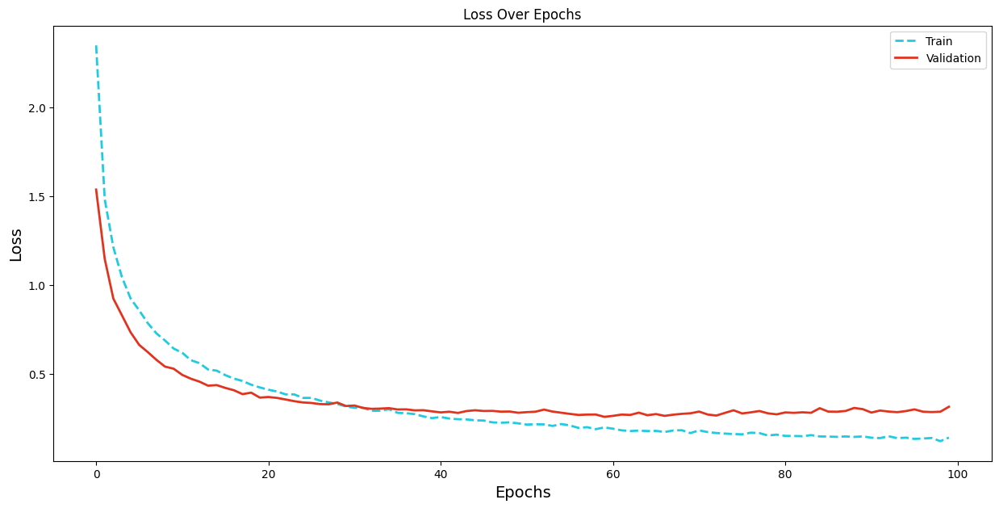

In [ ]:
loss_train_curve = model_history.history["loss"]
loss_val_curve = model_history.history["val_loss"]

plt.figure(figsize=(15, 7))
plt.plot(loss_train_curve, label="Train", color="#1ECBE1", linestyle="--", linewidth=2)
plt.plot(loss_val_curve, label="Validation", color="#E1341E", linestyle="-", linewidth=2)
plt.legend(loc='upper right')
plt.title("Loss Over Epochs")
plt.xlabel("Epochs", fontsize=14)
plt.ylabel("Loss", fontsize=14)
plt.show()

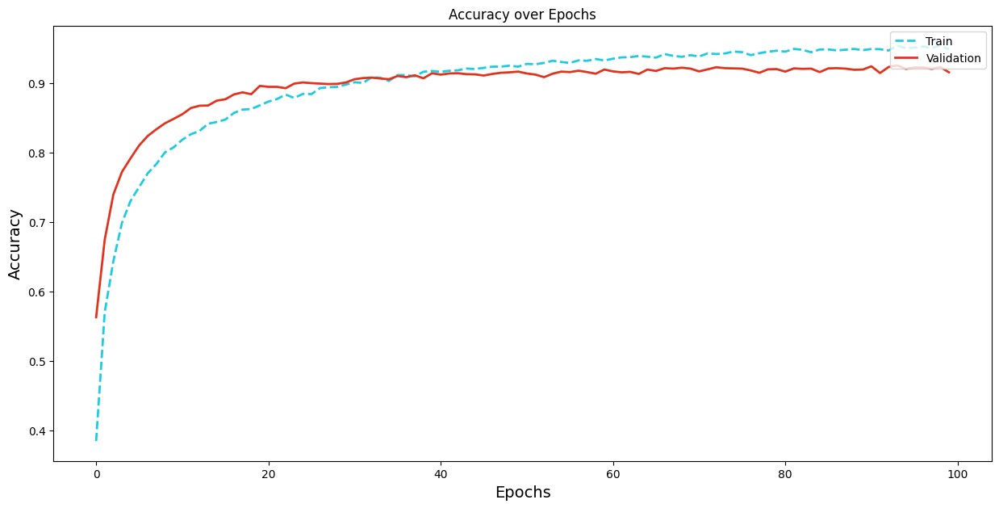

In [ ]:
acc_train_curve = model_history.history["accuracy"]
acc_val_curve = model_history.history["val_accuracy"]

plt.figure(figsize=(15, 7))
plt.plot(acc_train_curve, label="Train", color="#1ECBE1", linestyle="--", linewidth=2)
plt.plot(acc_val_curve, label="Validation", color="#E1341E", linestyle="-", linewidth=2)
plt.legend(loc='upper right')
plt.title("Accuracy over Epochs")
plt.xlabel("Epochs", fontsize=14)
plt.ylabel("Accuracy", fontsize=14)
plt.show()

In [ ]:
model.save('./CNN_tkeo_marine_mammals.keras')

In [ ]:
model = tf.keras.models.load_model('./CNN_marine_mammals.keras')
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 512)                 │          11,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 45)                  │           2,925 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 560,009 (2.14 MB)

 Trainable params: 186,669 (729.18 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 373,340 (1.42 MB)

In [ ]:
predictions= np.argmax(model.predict(X_val), axis=1)

95/95 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(y_val, predictions)
print(f"Accuracy: {accuracy}")

precision = precision_score(y_val, predictions, average='weighted')
print(f"Precision: {precision}")

recall = recall_score(y_val, predictions, average='weighted')
print(f"Recall: {recall}")

f1 = f1_score(y_val, predictions, average='weighted')
print(f"F1-Score: {f1}")

Accuracy: 0.9297315213788532
Precision: 0.9301686093996274
Recall: 0.9297315213788532
F1-Score: 0.9282658057013954


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_val, predictions))

              precision    recall  f1-score   support

           0       0.95      0.98      0.96        54
           1       0.64      0.30      0.41        30
           2       0.92      0.82      0.87        40
           3       0.76      0.93      0.84        45
           4       0.80      0.80      0.80         5
           5       0.82      0.93      0.87        69
           6       0.95      0.95      0.95        66
           7       0.90      0.91      0.90       172
           8       1.00      0.99      0.99        90
           9       0.99      1.00      1.00       124
          10       0.93      0.90      0.92        31
          11       0.93      0.95      0.94        56
          12       0.56      1.00      0.71         5
          13       0.94      0.93      0.94       128
          14       0.98      0.98      0.98       504
          15       0.67      0.57      0.62         7
          16       0.87      0.95      0.91       245
          17       0.94    

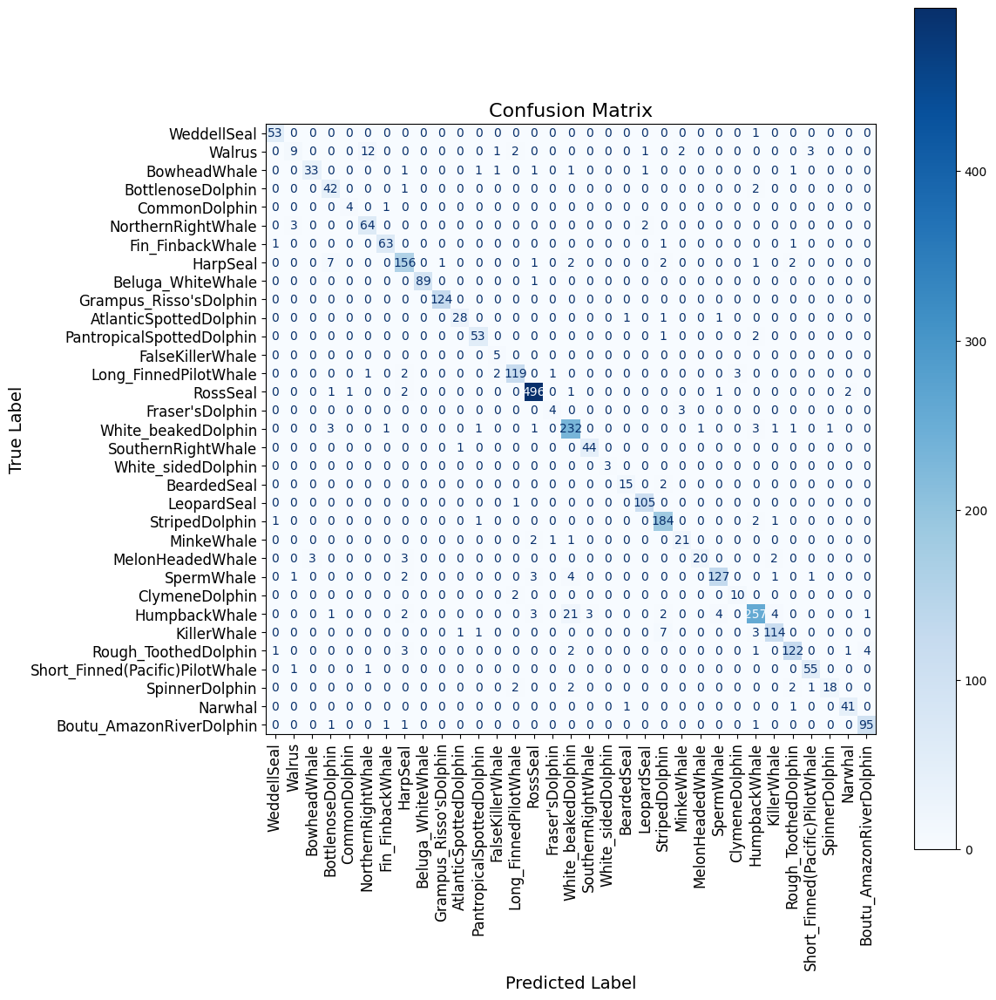

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

original_labels = class_list.unique()
cm = confusion_matrix(y_val, predictions)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=original_labels)
fig, ax = plt.subplots(figsize=(12, 12))
disp.plot(
    cmap='Blues',
    ax=ax,
    values_format='d'
)

ax.set_title("Confusion Matrix", fontsize=16)
ax.set_xlabel("Predicted Label", fontsize=14)
ax.set_ylabel("True Label", fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()